In [1]:
# Put these at the top of every notebook, to get automatic reloading and inline plotting
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
# This file contains all the main external libs we'll use
import fastai
from fastai.imports import *
from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *

In [7]:
PATH = "/scratch/as3ek/chrc_data_case_preserved_1000_normal/"
sz=256
arch=resnet50

In [8]:
torch.cuda.is_available()

True

In [9]:
torch.backends.cudnn.enabled

True

In [10]:
os.listdir(PATH)

['valid', 'train']

In [11]:
files = os.listdir(f'{PATH}valid/Celiac')[:5]
files

['C04-17_01___2000_2000___500_250.jpg',
 'C12-61_03___3000_3000___0_250.jpg',
 'C06-31_02___5000_3000___0_500.jpg',
 'C12-64_01b___14000_4000___250_250.jpg',
 'C10-47_01___0_6000___500_500.jpg']

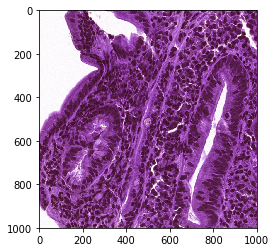

In [12]:
img = plt.imread(f'{PATH}valid/Celiac/{files[4]}')
plt.imshow(img);

In [18]:
arch=resnet50
data = ImageClassifierData.from_paths(PATH, tfms=tfms_from_model(arch, sz), bs=32)
learn = ConvLearner.pretrained(arch, data, precompute=True)

In [19]:
learn.metrics = []
learn.fit(0.001, 2)

epoch      trn_loss   val_loss                                 
    0      0.44015    0.591049  
    1      0.427804   0.590749                                 


[0.5907486494354208]

In [20]:
# This is the label for a val data
data.val_y

array([0, 0, 0, ..., 1, 1, 1])

In [21]:
# from here we know that 'Celiac' is label 0 and 'EE' is label 1 and 'Normal' is label 2
data.classes

['Celiac', 'Normal']

## Data Augmentation

In [22]:
# Using predefined augmentations transforms_top_down
tfms = tfms_from_model(resnet50, sz=256, aug_tfms=transforms_top_down, max_zoom=1.1)

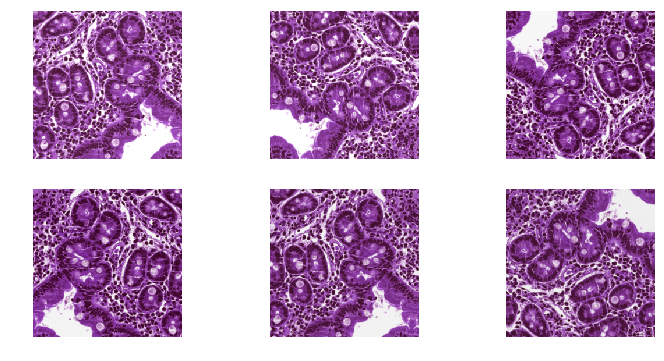

In [23]:
# Visualising the augmentation
def get_augs():
    data = ImageClassifierData.from_paths(PATH, bs=2, tfms=tfms, num_workers=1)
    x,_ = next(iter(data.aug_dl))
    return data.trn_ds.denorm(x)[1]
ims = np.stack([get_augs() for i in range(6)])
plots(ims, rows=2)

In [24]:
# Initializing the data with augmentation and learn method
data = ImageClassifierData.from_paths(PATH, tfms=tfms, bs=32)
learn = ConvLearner.pretrained(arch, data, precompute=False)
learn.precompute = False

In [25]:
lrf=learn.lr_find()

 76%|███████▌  | 1978/2598 [34:46<18:12,  1.76s/it, loss=2.08]   

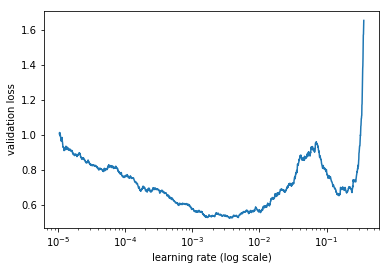

In [26]:
learn.sched.plot()

## Unfreezing layers and using Differential learning rates

In [30]:
# Unfreeze all layers for training
learn.unfreeze()

In [31]:
lr = (1e-2 + 1e-3)/2

In [32]:
lr=np.array([lr/9,lr/3,lr])

In [ ]:
learn.fit(lr, 3, cycle_len=1, cycle_mult=2)

epoch      trn_loss   val_loss   accuracy   
    0      0.146137   0.330712   0.869421  
    1      0.103318   0.380187   0.867965  
    2      0.057836   0.37082    0.878519  
    3      0.066102   0.364203   0.877302  
 71%|███████   | 3781/5335 [24:30<07:57,  3.26it/s, loss=0.0482]

In [ ]:
learn.save('1000x1000_256_resnet50_staintools')

In [17]:
learn.load('1000x1000_256_resnet50_staintools')

## Analyzing results

### Confusion Matrix and Accuracy with Test Time Augmentation

In [18]:
# Getting log predictions with TTA
log_preds,y = learn.TTA()
probs = np.mean(np.exp(log_preds),0)
accuracy_np(probs, y)

0.8829279971270674

In [19]:
log_preds.shape

(5, 50123, 3)

In [52]:
np.save('../results/logpreds_resnet50_all_layers256x256_duplicates_TTA_staintools.npy', log_preds)

In [53]:
log_preds = np.load('../results/logpreds_resnet50_all_layers256x256_duplicates_TTA_staintools.npy')

In [20]:
log_preds_mean = np.mean(log_preds, 0)

In [21]:
preds = np.argmax(probs, axis=1)

In [39]:
from sklearn.metrics import confusion_matrix
cnf_matrix = confusion_matrix(y, preds)
np.set_printoptions(precision=2)

In [41]:
data.classes

['Celiac', 'EE', 'Normal']

[[0.78 0.   0.21]
 [0.   1.   0.  ]
 [0.14 0.   0.86]]


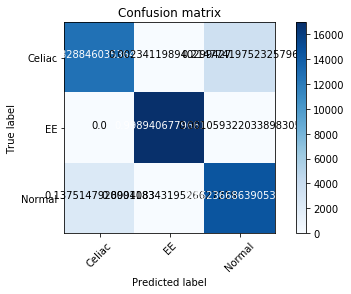

In [40]:
plot_confusion_matrix(cm, data.classes, normalize=True)

In [25]:
data.val_dl.dataset.fnames[0] in list(data.trn_dl.dataset.fnames)

False

In [26]:
res = pd.DataFrame(np.exp(log_preds_mean))

In [27]:
res['file'] = data.val_ds.fnames

In [28]:
res.columns = ['Celiac', 'EE', 'Normal', 'FileName']

In [29]:
res.to_csv('../results/preds_resnet50_256.csv')

In [30]:
res.head()

,Celiac,EE,Normal,FileName
0,0.999989,4.067119e-08,0.000012,valid/Celiac/C12-64_01a___6000_4000___0_250_0.jpg
1,0.979840,5.339724e-07,0.020159,valid/Celiac/C16-77_02___4000_0___0_0_0.jpg
2,0.999990,1.476365e-07,0.000009,valid/Celiac/C10-47_02___16000_18040___500_0_0...
3,0.999185,1.615475e-08,0.000815,valid/Celiac/C16-77_01___4000_2000___500_0_0.jpg
4,0.621023,5.738719e-08,0.378977,valid/Celiac/C11-54_05___3000_2000___500_250_0...


### Visualizing results with TTA

Most Correct Celiac


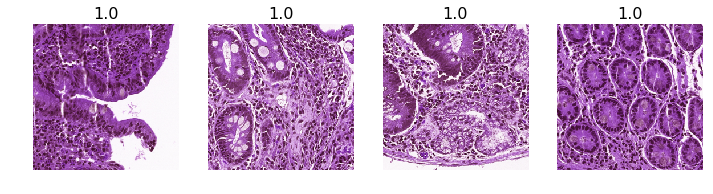

In [58]:
imr = ImageModelResults(data.val_ds, log_preds_mean)
print('Most Correct Celiac')
imr.plot_most_correct(0)

Most Correct EE


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


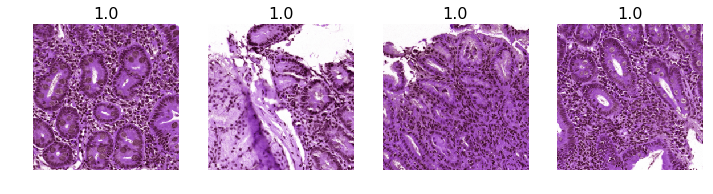

In [59]:
print('Most Correct EE')
imr.plot_most_correct(1)

Most Correct Noraml


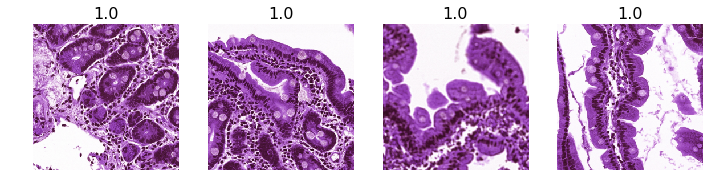

In [60]:
print('Most Correct Noraml')
imr.plot_most_correct(2)

Most Incorrect Celiac


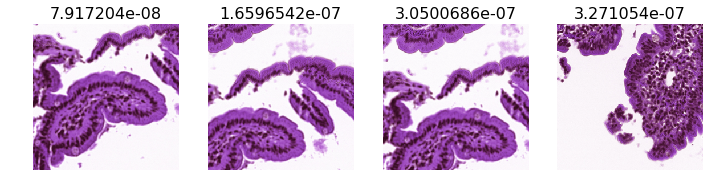

In [61]:
print('Most Incorrect Celiac')
imr.plot_most_incorrect(0)

Most Incorrect EE


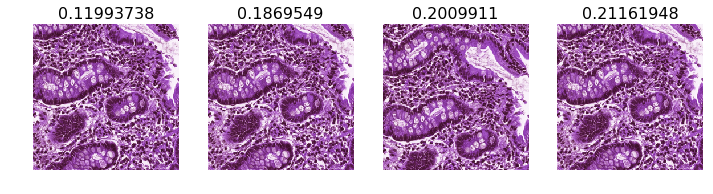

In [62]:
print('Most Incorrect EE')
imr.plot_most_incorrect(1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Most Incorrect Normal


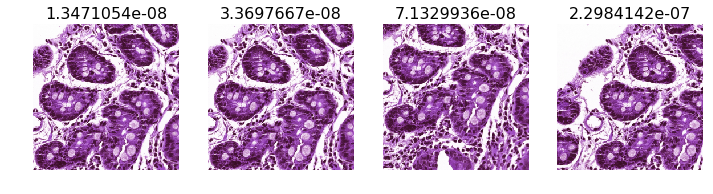

In [63]:
print('Most Incorrect Normal')
imr.plot_most_incorrect(2)

Most Uncertain Celiac


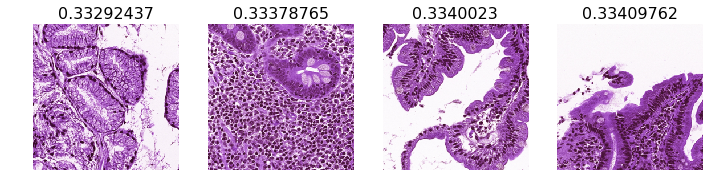

In [64]:
print('Most Uncertain Celiac')
imr.plot_most_uncertain(0)

Most Uncertain EE


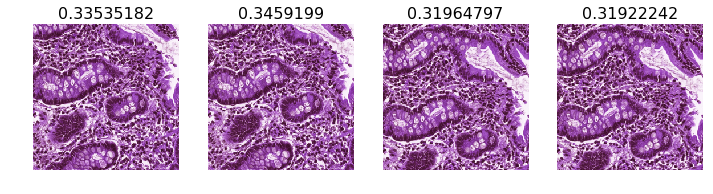

In [65]:
print('Most Uncertain EE')
imr.plot_most_uncertain(1)

Most Uncertain Normal


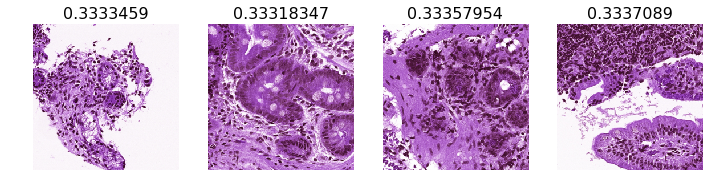

In [66]:
print('Most Uncertain Normal')
imr.plot_most_uncertain(2)

## DeConvs

In [25]:
learn.precompute = False
learn.predict()

array([[ -0.00003, -15.78801, -10.53465],
       [ -0.04049, -13.46168,  -3.22689],
       [ -0.00003, -14.30122, -10.28525],
       ...,
       [-11.01812, -14.84133,  -0.00002],
       [ -4.08751,  -6.16111,  -0.01907],
       [ -5.35514, -16.16134,  -0.00473]], dtype=float32)

In [27]:
model = learn.model

In [69]:
# Some Helper functions
from PIL import Image
def image_loader(path, expand_dim=False):
    img = Image.open(path)
#     img = img.resize((256, 256))
    img = np.array(img, dtype=np.float32)
    img = np.einsum('ijk->kij', img)
    if expand_dim:
        img = img[None]
    # convert to torch 
    img = torch.from_numpy(img)
    return img

In [70]:
def return_sequential(layer_num, model):
    return nn.Sequential(
            *list(model.children())[:layer_num]
        )

class get_activation_layer(nn.Module):
    def __init__(self, model, total_layers):
        super().__init__()
        self.model = model
        self.total_layers = total_layers
        self.layer_models = []
        for i in range(self.total_layers):
             self.layer_models.append(return_sequential(i, self.model))
    def forward(self, x):
        self.outputs = []
        for i in range(self.total_layers):
            self.outputs.append(self.layer_models[i](x))
        return self.outputs

In [71]:
tmp_model = get_activation_layer(learn.model, 16)

In [72]:
!mkdir ../layers_vis/model_1000x1000_256_resnet50/

In [73]:
def visulaize_layers(outputs):
    for index, layer in enumerate(outputs):
        features = layer.data
        size_plot = features.shape[1]
        if size_plot % 2 != 0:
            size_plot += 1
        original_size = np.int(np.ceil(np.sqrt(size_plot)))
        f, axarr = plt.subplots(original_size + 1, original_size + 1, figsize=(40,40))
        i, j = 0,0
        counter = 1
        for blocks in features:
            for block in blocks:
                counter += 1
                x = block.cpu().numpy()
                if counter % original_size == 0:
                    i += 1
                    j = 0 

                axarr[i,j].imshow(x)
                j += 1
        counter = 0
        print(f'layer {index} done')
        f.savefig(f'../layers_vis/model1000x1000_256_resnet50/output{index}.jpg')
        print('image generated')
        if (index == 10):
            break

In [74]:
img = data.val_dl.get_batch([1])[0]
layer_outputs = tmp_model(Variable(V(img)))

In [ ]:
visulaize_layers(layer_outputs)

layer 0 done
image generated
layer 1 done
image generated
layer 2 done
image generated
layer 3 done
image generated
layer 4 done
image generated
layer 5 done
image generated
layer 6 done
image generated
layer 7 done
image generated
layer 8 done
image generated
layer 9 done
image generated


## Grad CAM

In [17]:
model

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1

In [28]:
def get_cat_name(a):
    if a == 0:
        return 'Celiac'
    elif a == 1:
        return 'EE'
    elif a == 2:
        return 'Normal'
    else:
        return 'Something Wrong with label!'

In [29]:
class SaveFeatures():
    features=None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): self.features = output
    def remove(self): self.hook.remove()

In [30]:
def plt_heatmap():
    
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    it = iter(data.val_dl)
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = next(it)
        x,y = x[None,0], y[None,0]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
        sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
        py = m(vx)
        for o in sfs: o.remove()
        feat = np.maximum(0,to_np(sfs[0].features[0]))
        vx = Variable(x.cuda(), requires_grad=True)
        py = np.exp(to_np(py)[0])
        params = list(m.parameters())
        weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
        f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
        f2-=f2.min()
        f2/=f2.max()
        plt.imshow(dx)
        plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

/apps/software/standard/core/anaconda/5.2.0-py3.6/lib/python3.6/site-packages/ipykernel_launcher.py:26: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


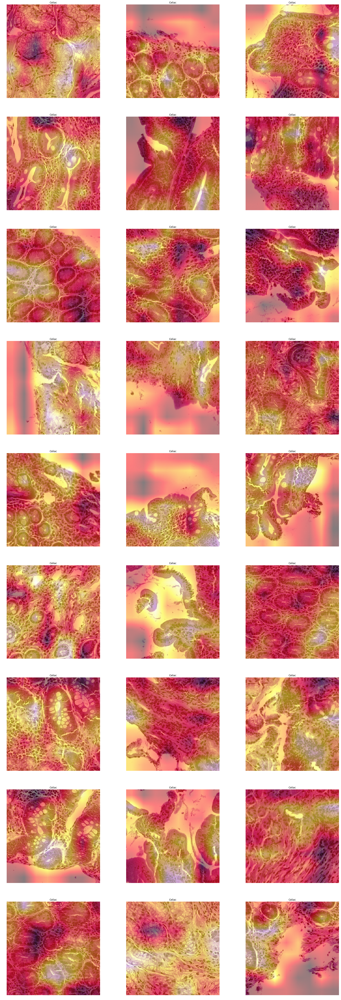

In [31]:
plt_heatmap()

In [32]:
def plt_heatmap_EE():
    
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    batch_iter = iter(data.val_dl)
    for k in range(1185):
        next(batch_iter)
#         print(k)
    print('Iterated!')
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = next(batch_iter)
        x,y = x[None,0], y[None,0]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
        sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
        py = m(vx)
        for o in sfs: o.remove()
        feat = np.maximum(0,to_np(sfs[0].features[0]))
        vx = Variable(x.cuda(), requires_grad=True)
        py = np.exp(to_np(py)[0])
        params = list(m.parameters())
        weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
        f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
        f2-=f2.min()
        f2/=f2.max()
        plt.imshow(dx)
        plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

Iterated!


/apps/software/standard/core/anaconda/5.2.0-py3.6/lib/python3.6/site-packages/ipykernel_launcher.py:30: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


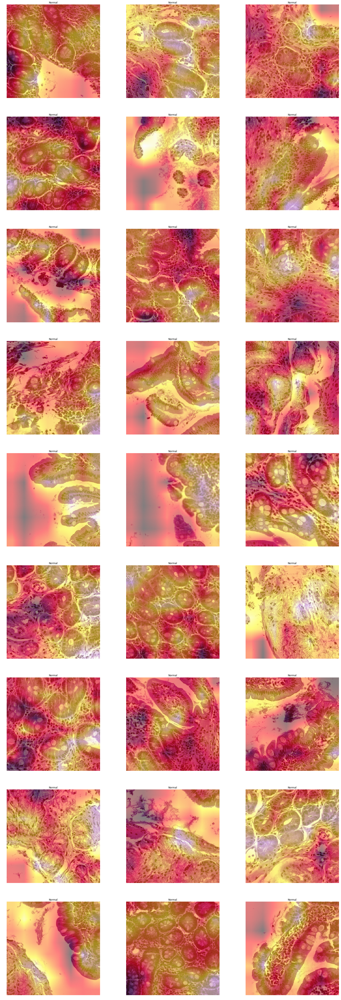

In [33]:
plt_heatmap_EE()

In [36]:
def plt_heatmap_Normal():
    m = nn.Sequential(*children(learn.model))
    figure = plt.figure(figsize=(30, 90))
    batch_iter = iter(data.val_dl)
    for k in range(1000):
        next(batch_iter)
#         print(k)
    print('Iterated!')
    for i in range(27):
        subplot = figure.add_subplot(9, 3, i+1)
        subplot.axis('Off')
        x,y = next(batch_iter)
        x,y = x[None,0], y[None,0]
        subplot.set_title(get_cat_name(y))
        vx = Variable(x.cuda(), requires_grad=True)
        dx = data.val_ds.denorm(x)[0]
        sfs = [SaveFeatures(o) for o in [m[-11][1]._modules['conv2']]]
        py = m(vx)
        for o in sfs: o.remove()
        feat = np.maximum(0,to_np(sfs[0].features[0]))
        vx = Variable(x.cuda(), requires_grad=True)
        py = np.exp(to_np(py)[0])
        params = list(m.parameters())
        weight_softmax = np.squeeze(params[-2].data.cpu().numpy())
        f2=np.dot(np.rollaxis(feat,0,3), weight_softmax[0])
        f2-=f2.min()
        f2/=f2.max()
        plt.imshow(dx)
        plt.imshow(scipy.misc.imresize(f2, dx.shape), alpha=0.5, cmap='hot');

Iterated!


/apps/software/standard/core/anaconda/5.2.0-py3.6/lib/python3.6/site-packages/ipykernel_launcher.py:29: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for f

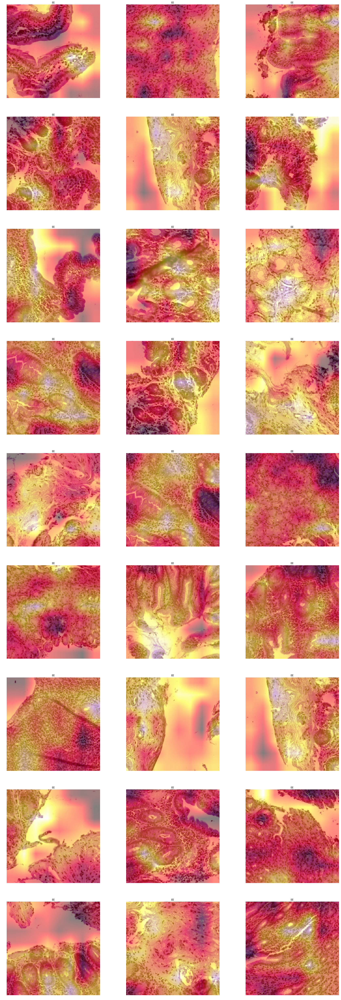

In [37]:
plt_heatmap_Normal()

## Saving predictions of the model with TTA

In [3]:
np.exp(log_preds_mean)

NameError: name 'log_preds_mean' is not defined

In [ ]:
res = pd.DataFrame(np.exp(log_preds_mean))

In [ ]:
res['file'] = data.val_ds.fnames

In [ ]:
res.columns = ['Celiac', 'EE', 'Normal', 'FileName']

In [ ]:
res.to_csv('../results/preds_resnet50_256_.csv')

In [ ]:
res.head()